Run CellRank using moslin couplings (ABpxp)
---
Use CellRank to compute terminal states, fate probabilities and driver genes on the ABpxp lineage. 

# Preliminaries

## Import packages

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# single-cell packages
import scanpy as sc
import scvelo as scv
import cellrank as cr
import anndata

# rest
import pickle
import warnings
import numpy as np
import pandas as pd
import sys
from scipy.stats import ttest_ind
from typing import *
from types import MappingProxyType
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

Check whether rpy2 works (needed only for gene trend plotting)

In [3]:
import rpy2.robjects as robjects

try:
    # Test whether the R package 'stats' can be loaded
    robjects.r('library(stats)')
    robjects.r('library(mgcv)')
    print('rpy2 is correctly installed')
except:
    print('rpy2 is not installed or not working properly')

R[write to console]: Lade nötiges Paket: nlme

R[write to console]: This is mgcv 1.8-42. For overview type 'help("mgcv-package")'.



rpy2 is correctly installed


Check the CellRank version

In [4]:
cr.logging.print_version_and_date()

Running CellRank 1.5.1+g6150f029, on 2023-04-01 12:45.


## Dependencies

This notebook depends on [ML_2023-03-31_moslin_abpxp.ipynb](ML_2023-03-31_moslin_abpxp.ipynb) and [ML_2023-03-31_palantir.ipynb](ML_2023-03-31_palantir.ipynb). 

## Define utility functions

Define a custom kernel class to convert moslin's couplings into a CellRank kernel. 

In [5]:
class CelegansKernel(cr.kernels.TransportMapKernel):
    def compute_transition_matrix(
        self,
        tmaps: Dict[Tuple[float, float], anndata.AnnData],
        threshold: Optional[str] = "auto",
        self_transitions: Union[
            Literal["uniform", "diagonal", "connectivities", "all"],
            Sequence[float],
        ] = "connectivities",
        conn_weight: Optional[float] = None,
        conn_kwargs: Mapping[str, Any] = MappingProxyType({}),
    ):
        self._tmaps = tmaps

        if threshold is not None:
            self._threshold_transport_maps(
                self.transport_maps, threshold=threshold, copy=False
            )

        tmap = self._restich_tmaps(
            self.transport_maps,
            self_transitions=self_transitions,
            conn_weight=conn_weight,
            **conn_kwargs,
        )

        self.transition_matrix = tmap.X
        return self

    def _compute_tmap(self):
        raise NotImplementedError()

Show pie chart over fine cluster distributions

In [6]:
def plot_pie_chart(adata, state: str, figsize=(5, 5), pctdistance=1.4, labeldistance=1.1, fontsize=10, 
                   annot=True, save=None):
    
    # subset to the target state on a coarse cluster level
    mask = adata.obs["coarse_clusters"] == state
    
    print(f"Showing the distribution for {state} (n_cells={np.sum(mask)})")
    
    # caluculate the distribution of this coarse state over sub-types
    value_counts = adata[mask].obs["plot.cell.type"].value_counts()
    
    # for the main clusters, obtain their colors
    color_mapping = {cluster: color for (cluster, color) in 
                     zip(adata.obs["clusters"].cat.categories, adata.uns["clusters_colors"])}

    # count how many are not among the main clusters
    n_not_found = np.sum(~value_counts.index.isin(color_mapping.keys()))

    # for these, obtain a range of grey values
    range_of_greys = [mcolors.to_hex(c) for c in plt.get_cmap("Greys")(np.linspace(0.1, 0.9, n_not_found))]
    
    # iterate over all sub-types, if we have a nice color for them, assign it, if not, assign some shade of grey
    colors = []
    i = 0

    for cl in value_counts.index:
        if cl in color_mapping.keys():
            colors.append(color_mapping[cl])
        else:
            colors.append(range_of_greys[i])
            i += 1

    # plot the distribution as a pie chart
    fig, ax = plt.subplots(figsize=figsize)
    
    # plot the pie chart
    shared_kwargs = {"startangle":90, "colors":colors}
    if annot:
        ax.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', textprops={'fontsize': fontsize},
          pctdistance=pctdistance, labeldistance=labeldistance, **shared_kwargs)
    else:
        ax.pie(value_counts, **shared_kwargs)
    
    ax.axis('equal')  # equal aspect ratio ensures that pie is drawn as a circle
    
    plt.tight_layout()
    
    if save is not None:
        plt.savefig(FIG_DIR / "pie_charts" / save)
    
    plt.show()

Return a sorted df of driver genes, subsetted to the relevant columns. 

In [7]:
def return_drivers(adata, state: str, q_thresh: Optional[float] = None, n_genes: int = 20, only_tf: bool = True):
    cols = ["Ensembl", "highly_variable", "Family", "TF", "Protein", f"{state}_pval", f"{state}_qval", f"{state}_corr", 
            "means", "dispersions"]
    
    if q_thresh is not None:
        mask = adata.var[f"{state}_qval"] < q_thresh
    else: 
        mask = np.ones(adata.n_vars).astype(bool)

    if only_tf:
        gene_df = adata[:, mask].var.loc[adata.var["TF"]].sort_values(by=f"{state}_corr", ascending=False).head(n_genes)[cols]
    else:
        gene_df = adata[:, mask].var.sort_values(by=f"{state}_corr", ascending=False).head(n_genes)[cols]           
    return gene_df

## Set up paths

Define the paths to load data, cache results and write figure panels.

In [8]:
sys.path.insert(0, "../../")  # this depends on the notebook depth and must be adapted per notebook

from paths import DATA_DIR, FIG_DIR

FIG_DIR = FIG_DIR / "packer_c_elegans"
DATA_DIR = DATA_DIR / "packer_c_elegans"

Set up the paths to save figures.

In [9]:
scv.settings.figdir = str(FIG_DIR)
sc.settings.figdir = str(FIG_DIR)
cr.settings.figdir = str(FIG_DIR)

## Set global parameters

In [10]:
DPI_SAVE = 400

scv.settings.set_figure_params('scvelo', dpi_save=DPI_SAVE, dpi=80, transparent=True, fontsize=20, color_map='viridis')
scv.settings.plot_prefix = ""

In [11]:
# should figures just be displayed or also saved?
save_figure = True

In [12]:
LINEAGE_INFO = "abpxp" # restrict our analysis to this lineage

## Import the data

Import the AnnData object. 

In [13]:
adata = sc.read(DATA_DIR / "ML_2023-03-31_c_elegans_abpxp_adata.h5ad")
adata

AnnData object with n_obs × n_vars = 6476 × 20222
    obs: 'idx', 'barcode', 'n.umi', 'time.point', 'batch', 'Size_Factor', 'cell.type', 'cell.subtype', 'plot.cell.type', 'raw.embryo.time', 'embryo.time', 'embryo.time.bin', 'raw.embryo.time.bin', 'lineage', 'passed_initial_QC_or_later_whitelisted', 'random_precise_lineage', 'clusters', 'coarse_clusters', 'assigned_batch_time', 'marginals', 'time', 'time_point'
    var: 'Ensembl', 'gene_short_name', 'Symbol', 'Family', 'Protein', 'Entrez_ID', 'TF', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'coarse_clusters_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'raw.embryo.time_colors', 'time_point_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

Import the moslin-computed couplings. 

In [14]:
with open(DATA_DIR / "ML_2023-03-31_c_elegans_abpxp_tmats.pkl", "rb") as f:
    tmats = pickle.load(f)

# Close the file
f.close()

Import MAGIC imported data and the Palantir pseudotime. 

In [15]:
# import
magic_imputed_data = pd.read_csv(DATA_DIR / "palantir" / "ML_2023-04-01_magic_imputed_data.csv", index_col=0)
palantir_pseudotime = pd.read_csv(DATA_DIR / "palantir" / "ML_2023-04-01_palantir_pseudotime.csv", index_col=0)

# make sure the indices overlap perfectly
assert((magic_imputed_data.index == adata.obs.index).all()), "MAGIC indices do not match with ours."
assert((palantir_pseudotime.index == adata.obs.index).all()), "Palantir pseudotime indices do not match with ours."

# write
adata.layers['magic_imputed_data'] = magic_imputed_data
adata.obs["palantir_pseudotime"] = palantir_pseudotime
adata

AnnData object with n_obs × n_vars = 6476 × 20222
    obs: 'idx', 'barcode', 'n.umi', 'time.point', 'batch', 'Size_Factor', 'cell.type', 'cell.subtype', 'plot.cell.type', 'raw.embryo.time', 'embryo.time', 'embryo.time.bin', 'raw.embryo.time.bin', 'lineage', 'passed_initial_QC_or_later_whitelisted', 'random_precise_lineage', 'clusters', 'coarse_clusters', 'assigned_batch_time', 'marginals', 'time', 'time_point', 'palantir_pseudotime'
    var: 'Ensembl', 'gene_short_name', 'Symbol', 'Family', 'Protein', 'Entrez_ID', 'TF', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_colors', 'coarse_clusters_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'raw.embryo.time_colors', 'time_point_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    layers: 'magic_imputed_data'
    obsp: 'connectivities', 'distances'

## Visualize in an embedding

saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_clusters.pdf


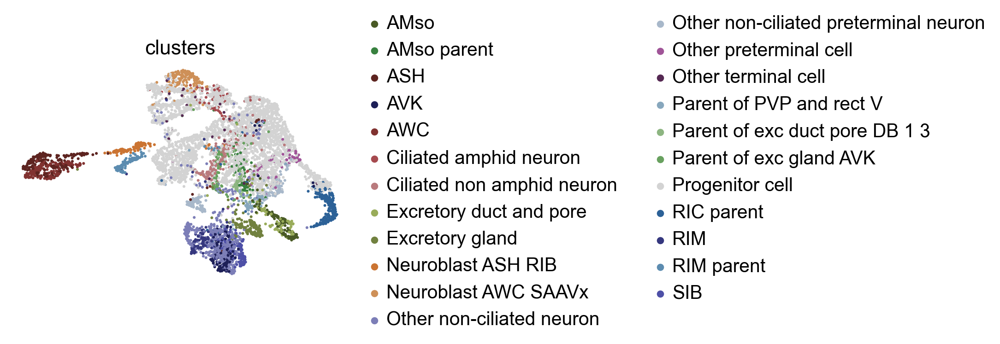

In [16]:
fig_kwargs = {'color': 'clusters', 'legend_loc': 'right', 's': 30}
if save_figure: fig_kwargs['save'] =  "umap_clusters.pdf"
scv.pl.scatter(adata, **fig_kwargs)

saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_coarse_clusters.pdf


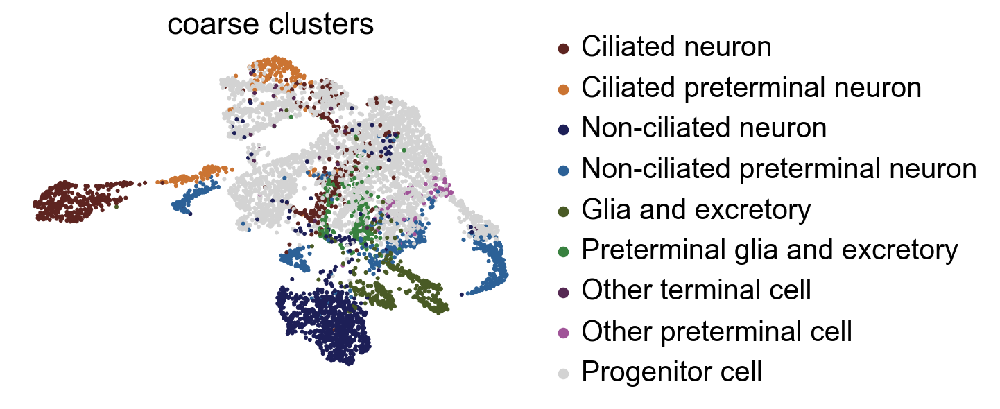

In [17]:
fig_kwargs = {'color': 'coarse_clusters', 'legend_loc': 'right', 's': 30}
if save_figure: fig_kwargs['save'] =  "umap_coarse_clusters.pdf"
scv.pl.scatter(adata, **fig_kwargs)

saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_lineage.pdf


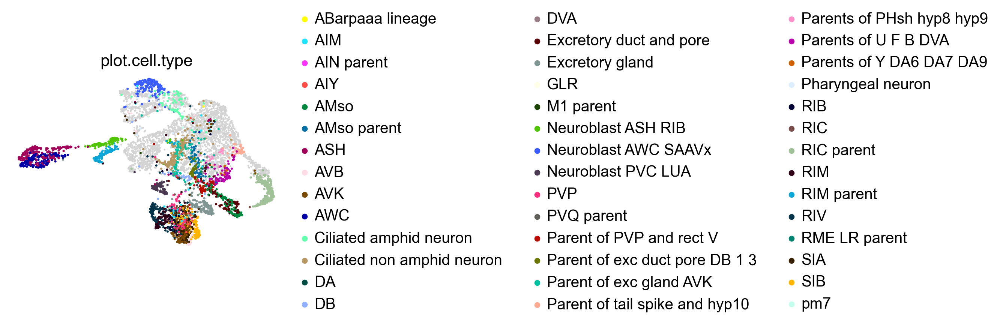

In [18]:
fig_kwargs = {'color': 'plot.cell.type', 'legend_loc': 'right', 's': 30}
if save_figure: fig_kwargs['save'] =  "umap_lineage.pdf"
scv.pl.scatter(adata, **fig_kwargs)

saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_time_point.pdf


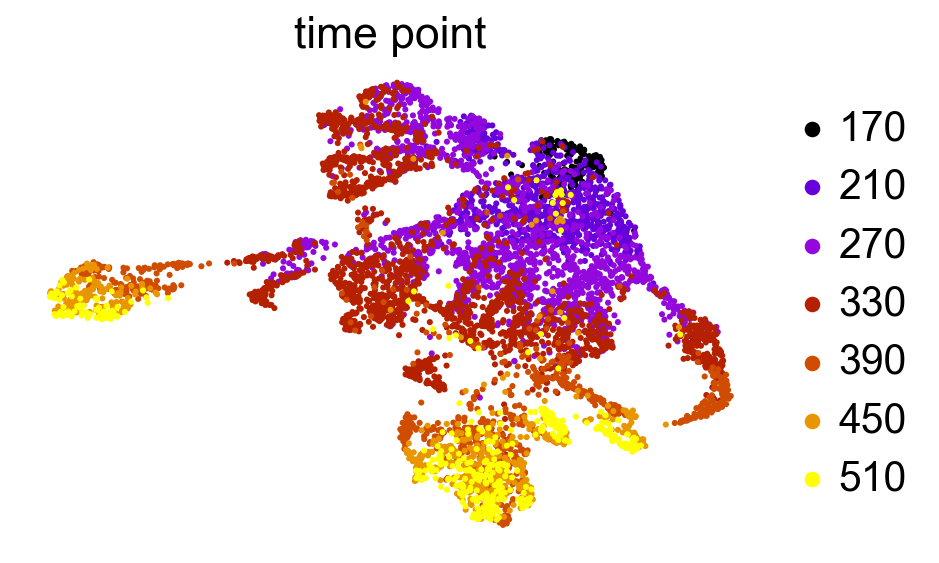

In [19]:
fig_kwargs = {'color': 'time_point', 'legend_loc': 'right', 's': 30}
if save_figure: fig_kwargs['save'] =  "umap_time_point.pdf"
scv.pl.scatter(adata, **fig_kwargs)

## Visualize the Palantir pseudotime

First, highlight the root cell on the UMAP

saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_palantir_root.pdf


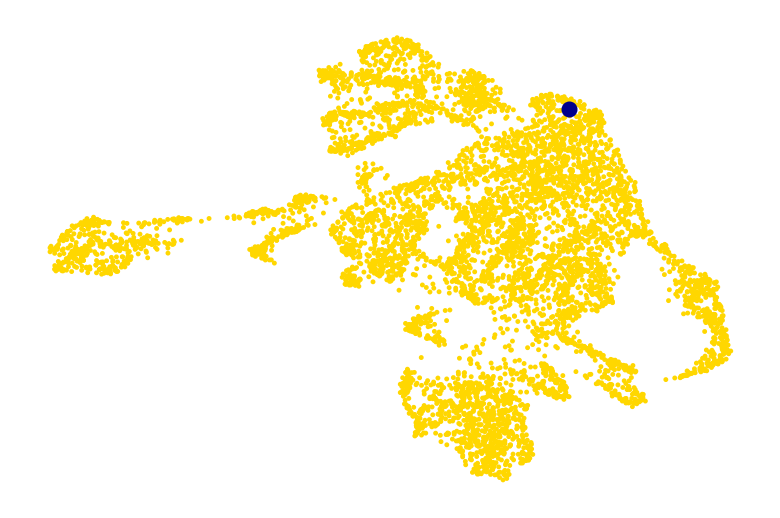

In [20]:
root_idx = np.flatnonzero(adata.obs["palantir_pseudotime"] == 0.0)[0]
fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  "umap_palantir_root.pdf"


scv.pl.scatter(adata, c=root_idx, **fig_kwargs)

Next, show the actual pseudotime in the embedding

saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_palantir_pseudotime.pdf


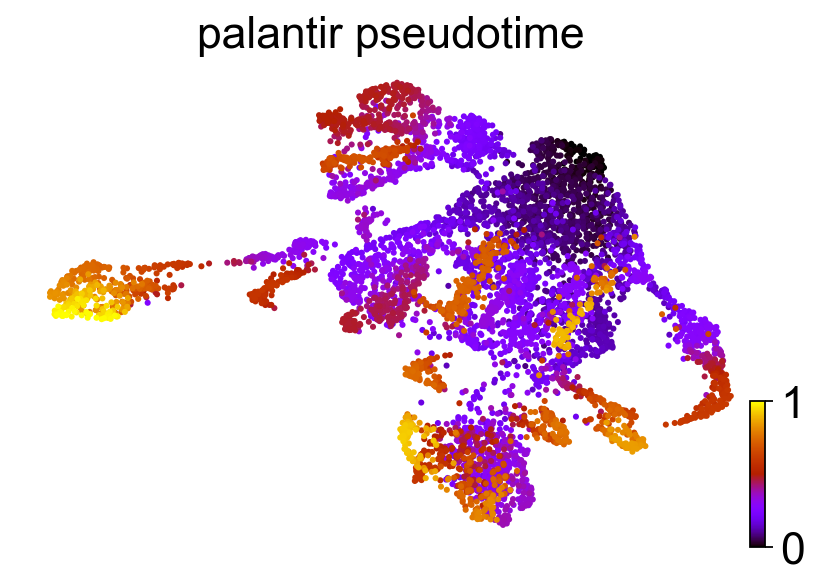

In [21]:
fig_kwargs = {'color': 'palantir_pseudotime', 'legend_loc': 'right', 's': 30, 
             'color_map': 'gnuplot'}
if save_figure: fig_kwargs['save'] =  "umap_palantir_pseudotime.pdf"

scv.pl.scatter(adata, **fig_kwargs)

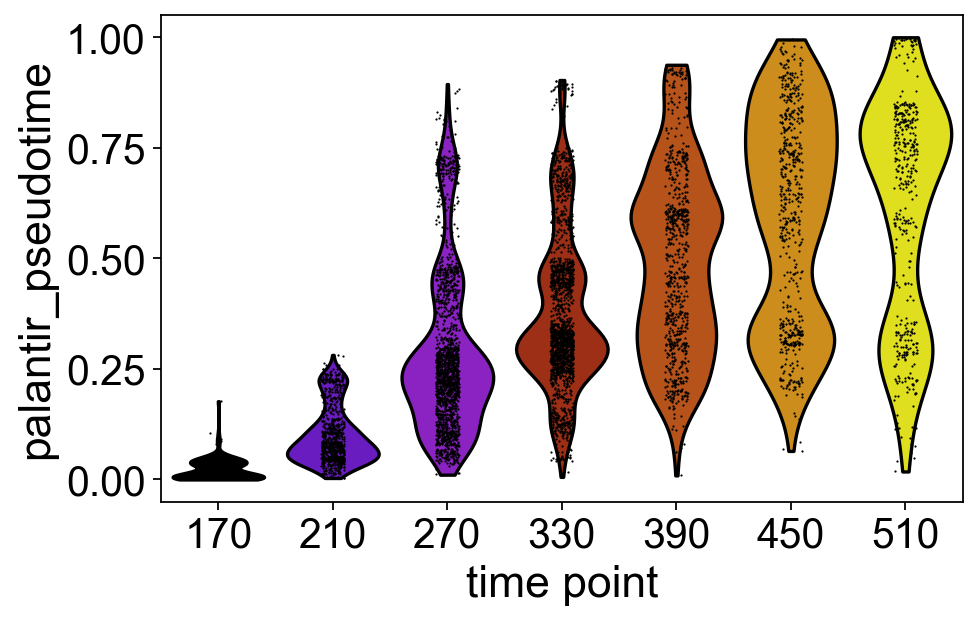

In [22]:
fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  "_palantir_time_point.pdf"

sc.pl.violin(adata, keys=["palantir_pseudotime"], groupby="time_point", **fig_kwargs)

## Cell state distribution within each terminal population

For each of the main groups we have here, like ciliated neurons, what sub-types do they consist of?

In [23]:
annot_kwargs = {"labeldistance":1.4, "pctdistance":1.7, "fontsize":10}

Ciliated neurons

Showing the distribution for Ciliated neuron (n_cells=647)


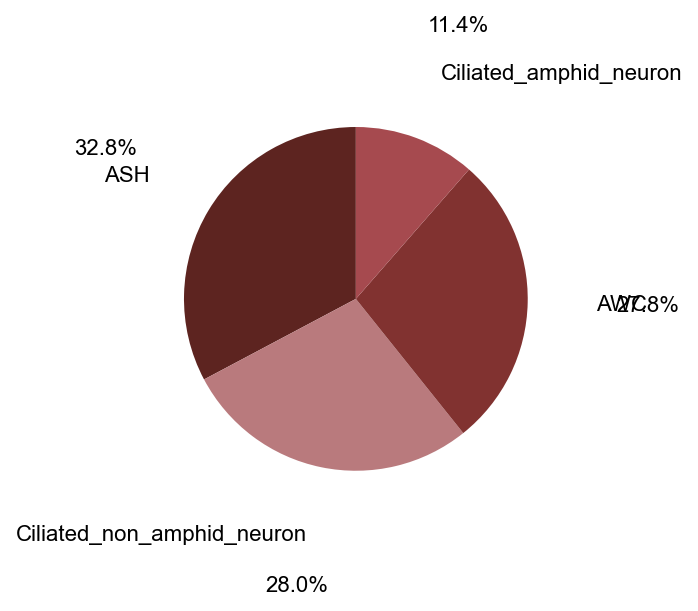

Showing the distribution for Ciliated neuron (n_cells=647)


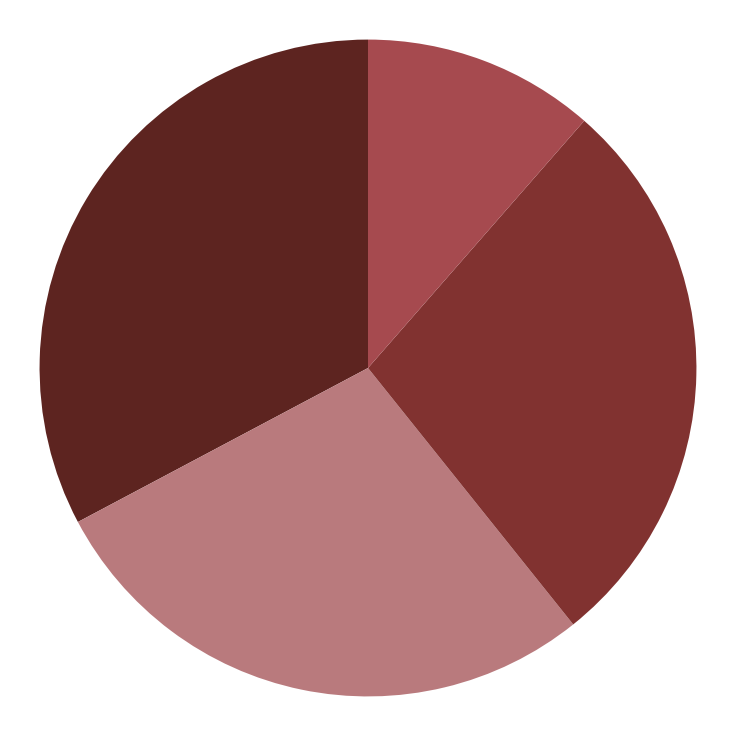

In [24]:
state = "Ciliated neuron"

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}_annotated.pdf"
plot_pie_chart(adata, state=state, annot=True, **annot_kwargs, **fig_kwargs)

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}.pdf"
plot_pie_chart(adata, state=state, annot=False, **fig_kwargs)

Non-ciliated neurons

Showing the distribution for Non-ciliated neuron (n_cells=890)


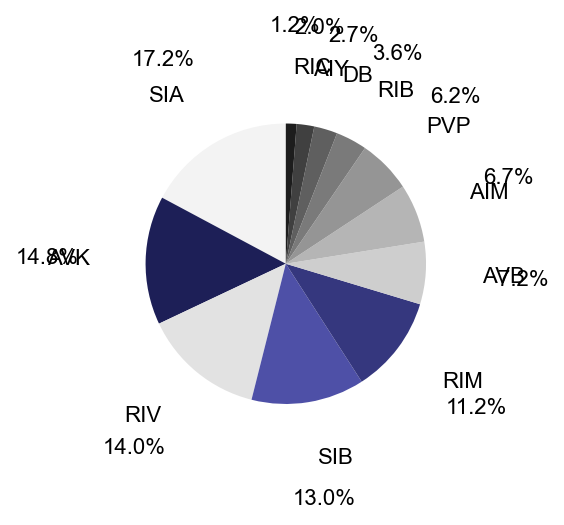

Showing the distribution for Non-ciliated neuron (n_cells=890)


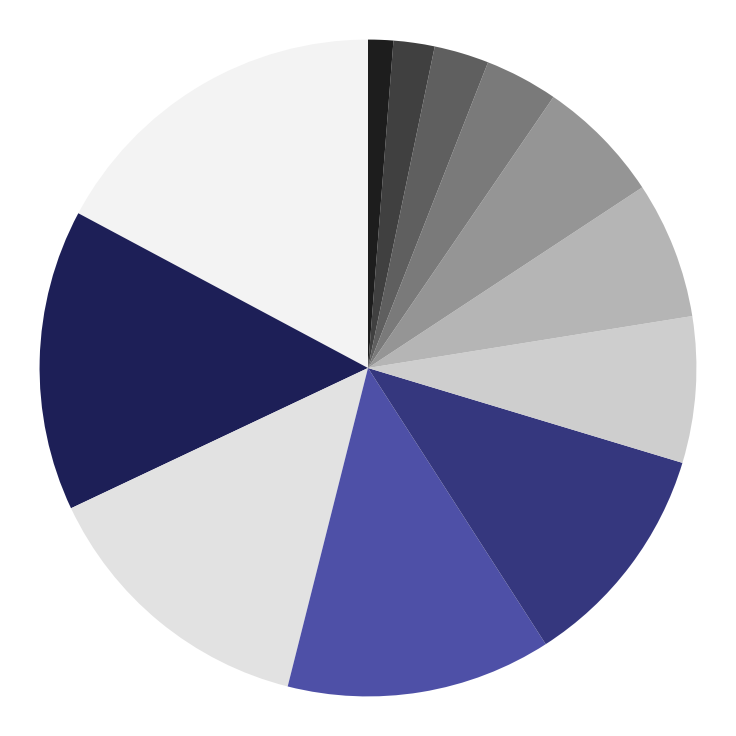

In [25]:
state = "Non-ciliated neuron"

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}_annotated.pdf"
plot_pie_chart(adata, state=state, annot=True, **annot_kwargs, **fig_kwargs)

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}.pdf"
plot_pie_chart(adata, state=state, annot=False, **fig_kwargs)

Glia and excretory

Showing the distribution for Glia and excretory (n_cells=361)


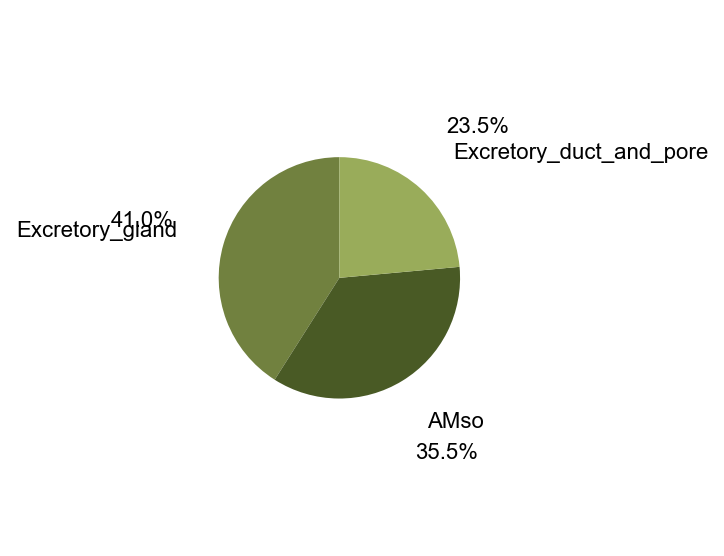

Showing the distribution for Glia and excretory (n_cells=361)


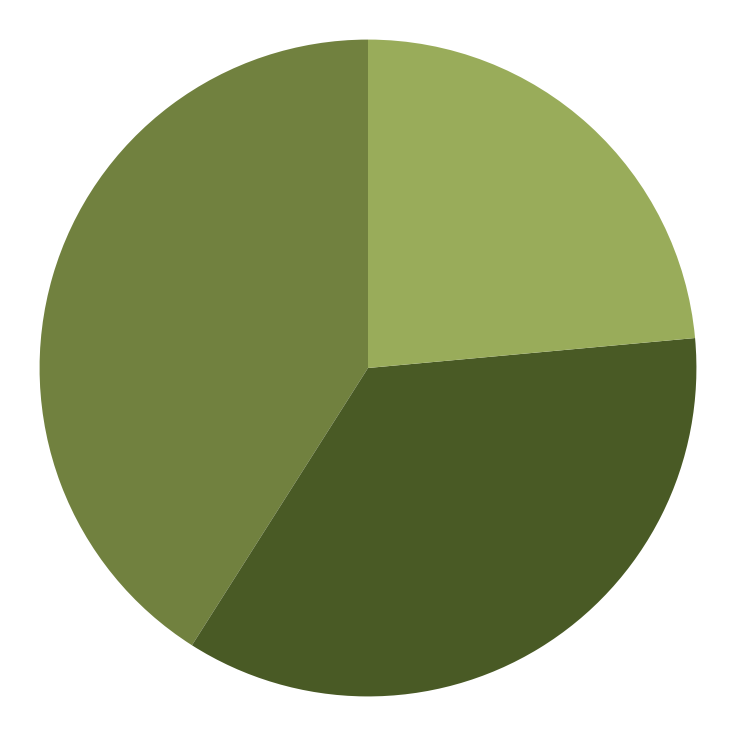

In [26]:
state = "Glia and excretory"

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}_annotated.pdf"
plot_pie_chart(adata, state=state, annot=True, **annot_kwargs, **fig_kwargs)

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}.pdf"
plot_pie_chart(adata, state=state, annot=False, **fig_kwargs)

Other terminal cell

Showing the distribution for Other terminal cell (n_cells=30)


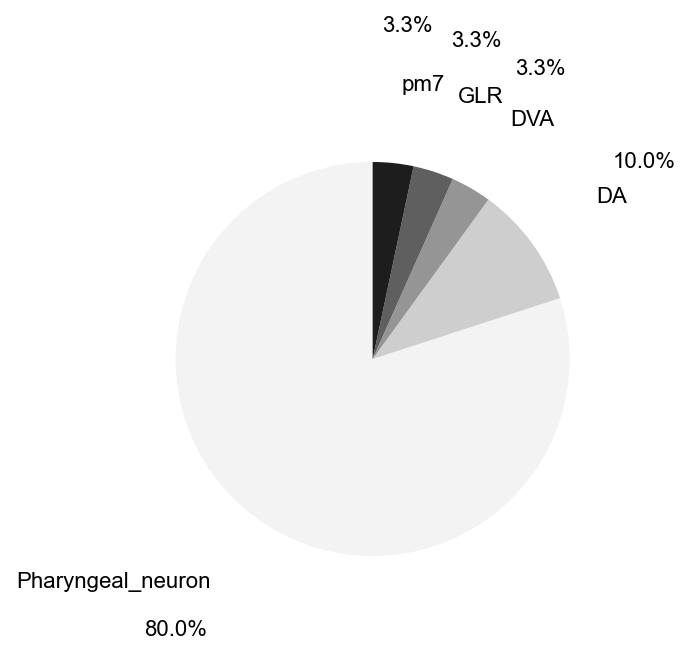

Showing the distribution for Other terminal cell (n_cells=30)


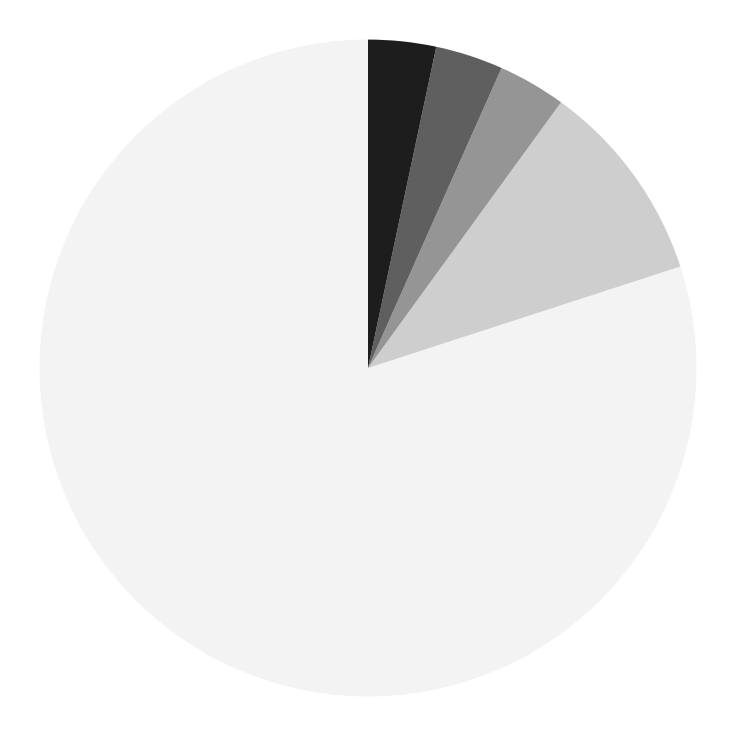

In [27]:
state = "Other terminal cell"

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}_annotated.pdf"
plot_pie_chart(adata, state=state, annot=True, **annot_kwargs, **fig_kwargs)

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}.pdf"
plot_pie_chart(adata, state=state, annot=False, **fig_kwargs)

## Cell state distribution within each pre-terminal population

For each of the main groups we have here, like ciliated neurons, what sub-types do they consist of?

In [28]:
annot_kwargs = {"labeldistance":1.4, "pctdistance":1.7, "fontsize":10}

Ciliated preterminal neurons

Showing the distribution for Ciliated preterminal neuron (n_cells=279)


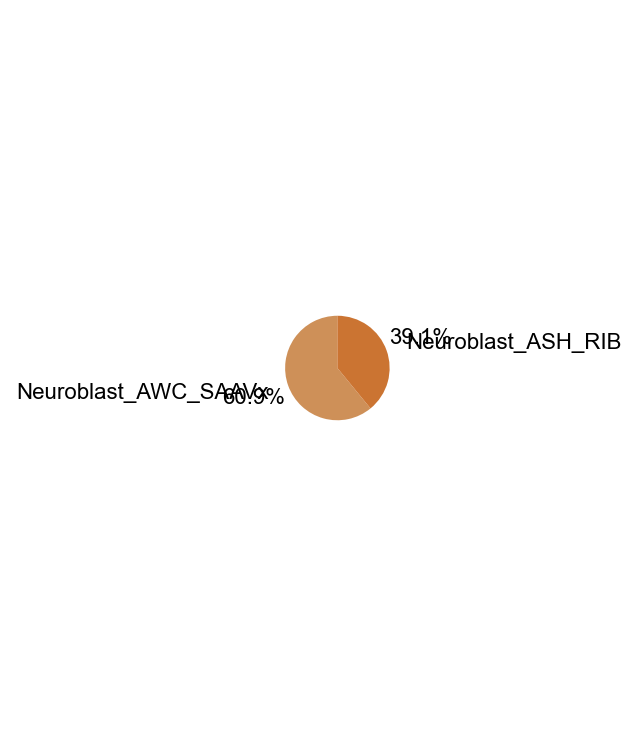

Showing the distribution for Ciliated preterminal neuron (n_cells=279)


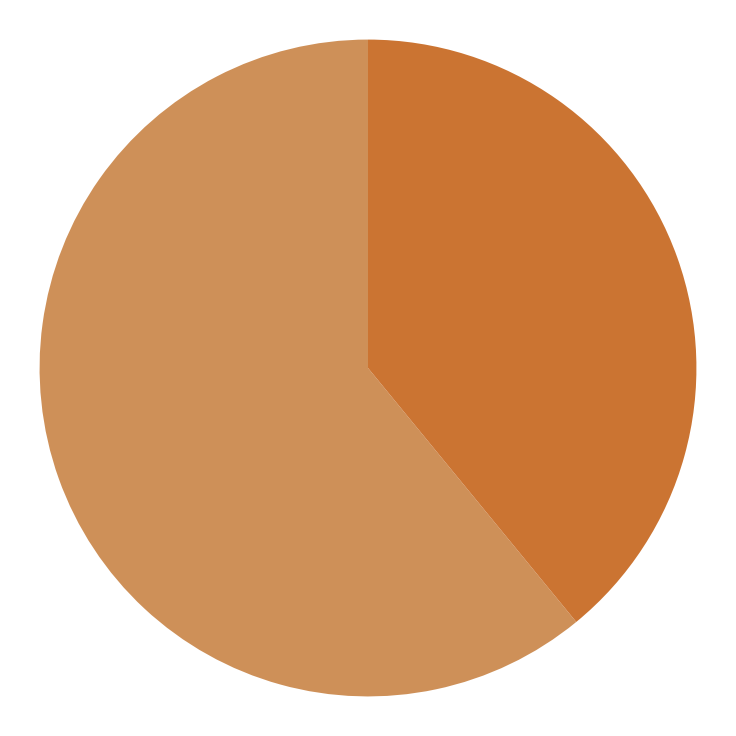

In [29]:
state = "Ciliated preterminal neuron"

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}_annotated.pdf"
plot_pie_chart(adata, state=state, annot=True, **annot_kwargs, **fig_kwargs)

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}.pdf"
plot_pie_chart(adata, state=state, annot=False, **fig_kwargs)

Non-ciliated preterminal neurons

Showing the distribution for Non-ciliated preterminal neuron (n_cells=576)


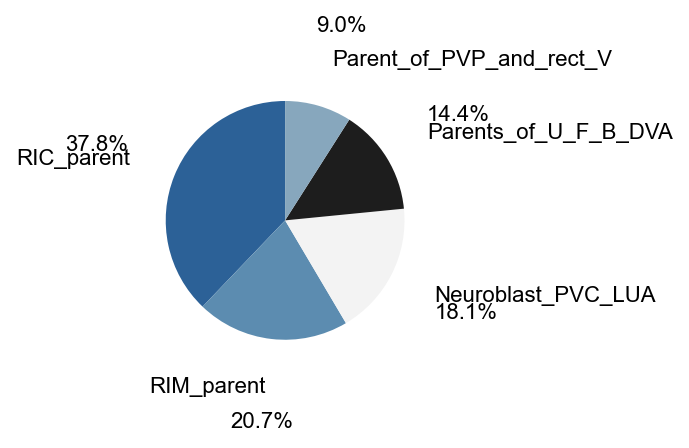

Showing the distribution for Non-ciliated preterminal neuron (n_cells=576)


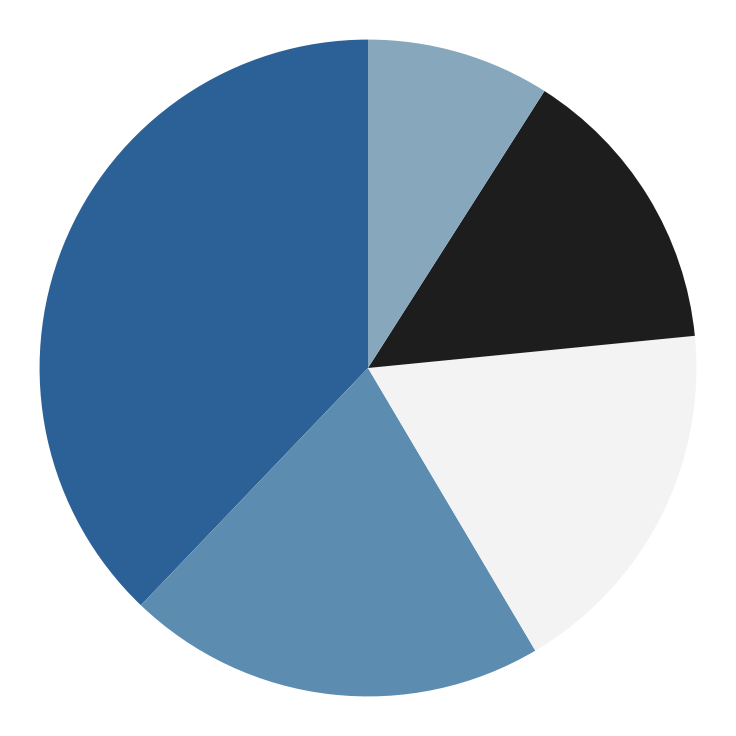

In [30]:
state = "Non-ciliated preterminal neuron"

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}_annotated.pdf"
plot_pie_chart(adata, state=state, annot=True, **annot_kwargs, **fig_kwargs)

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}.pdf"
plot_pie_chart(adata, state=state, annot=False, **fig_kwargs)

Preterminal glia and excretory

Showing the distribution for Preterminal glia and excretory (n_cells=231)


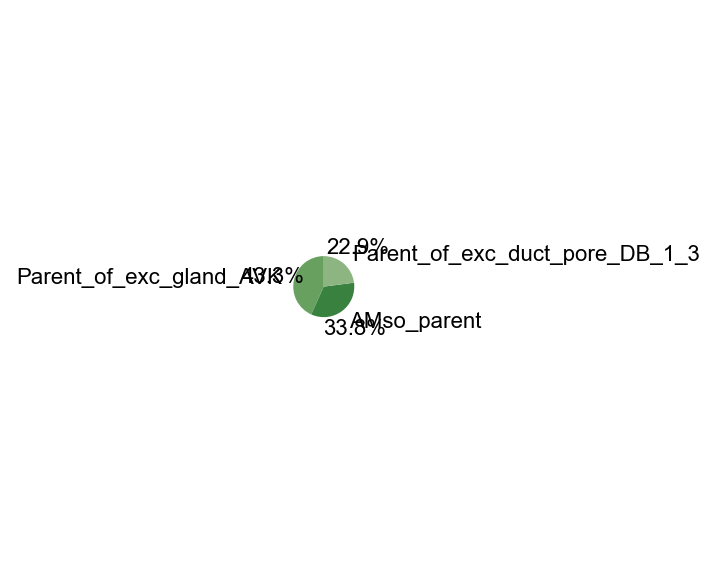

Showing the distribution for Preterminal glia and excretory (n_cells=231)


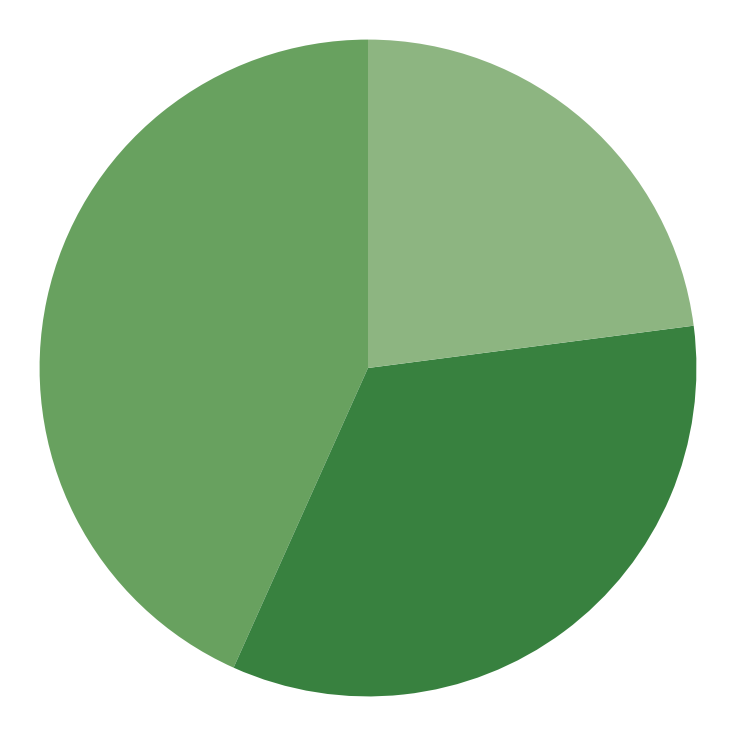

In [31]:
state = "Preterminal glia and excretory"

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}_annotated.pdf"
plot_pie_chart(adata, state=state, annot=True, **annot_kwargs, **fig_kwargs)

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}.pdf"
plot_pie_chart(adata, state=state, annot=False, **fig_kwargs)

Other preterminal cell

Showing the distribution for Other preterminal cell (n_cells=90)


/var/folders/qy/lhb83fbd5kj2syjlt8bwwrw00000gn/T/ipykernel_3913/2088725292.py:46: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


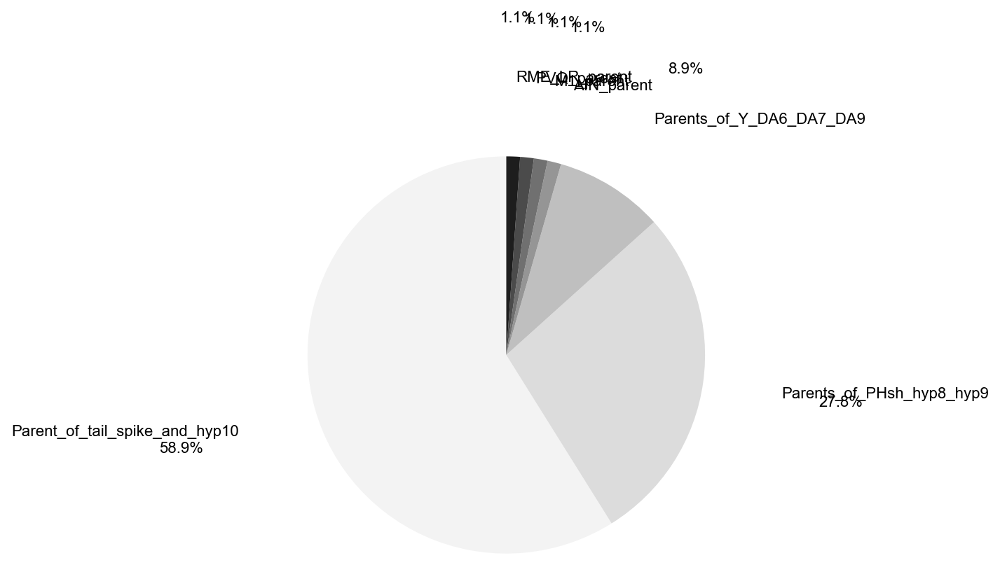

Showing the distribution for Other preterminal cell (n_cells=90)


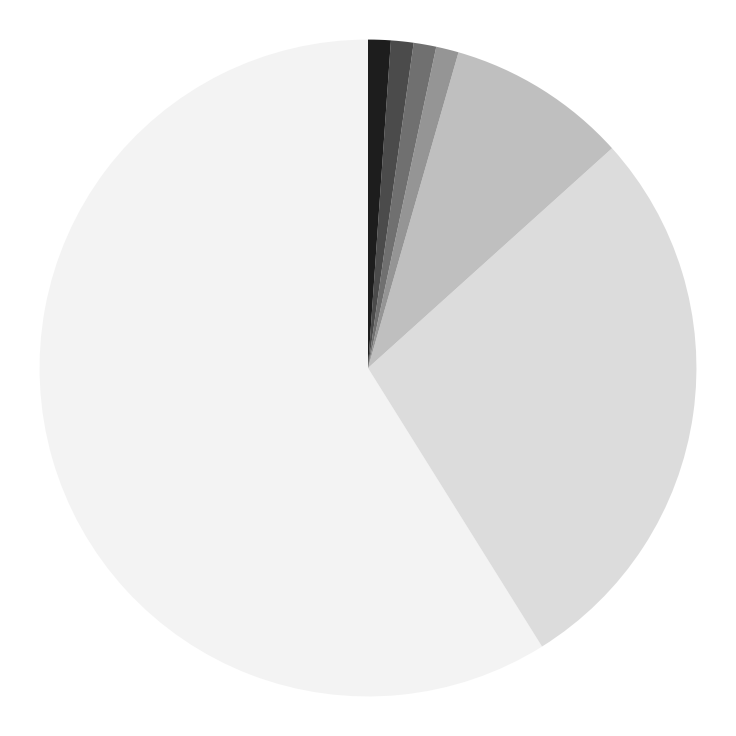

In [32]:
state = "Other preterminal cell"

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}_annotated.pdf"
plot_pie_chart(adata, state=state, annot=True, **annot_kwargs, **fig_kwargs)

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  f"{state}.pdf"
plot_pie_chart(adata, state=state, annot=False, **fig_kwargs)

# CellRank analysis

## Initialize a kernel

In [33]:
ck = CelegansKernel(adata, time_key="time_point").compute_transition_matrix(
    tmats, self_transitions="connectivities"
)
conn = cr.kernels.ConnectivityKernel(adata).compute_transition_matrix()
kernel = 0.9 * ck + 0.1 * conn

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


Somehow, this converts the categories to float. Let's change that back, and let's also make sure they are strings. 

In [34]:
cats = adata.obs["time_point"].cat.categories
if isinstance(cats[0], (int, float, complex)):
    mapping = {cat: str(int(cat)) for cat in cats}
    adata.obs["time_point"].cat.rename_categories(mapping, inplace=True)

Visualize the computed dynamics with random walks of a fixed length. 

100%|███████████████████████████████████████████████████████████████████████████| 200/200 [00:08<00:00, 22.43sim/s]


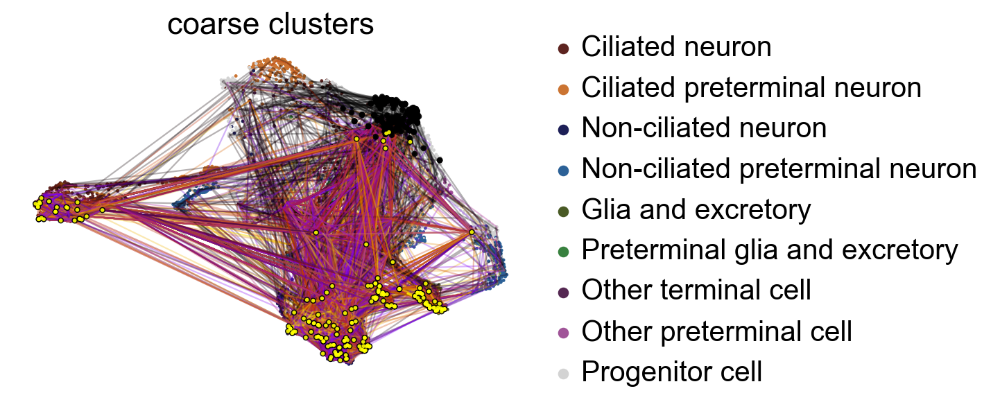

In [35]:
fig_kwargs = {'n_sims': 200, 'max_iter': 500, 
             'start_ixs': {"time_point": "170"}, 'c': "coarse_clusters", 'legend_loc':"right", "seed": 0}
if save_figure: fig_kwargs['save'] =  "umap_random_walks.pdf"

kernel.plot_random_walks(cmap="gnuplot",  **fig_kwargs)

## Compute terminal states

In [36]:
from cellrank.estimators import GPCCA

In [37]:
g = GPCCA(kernel)

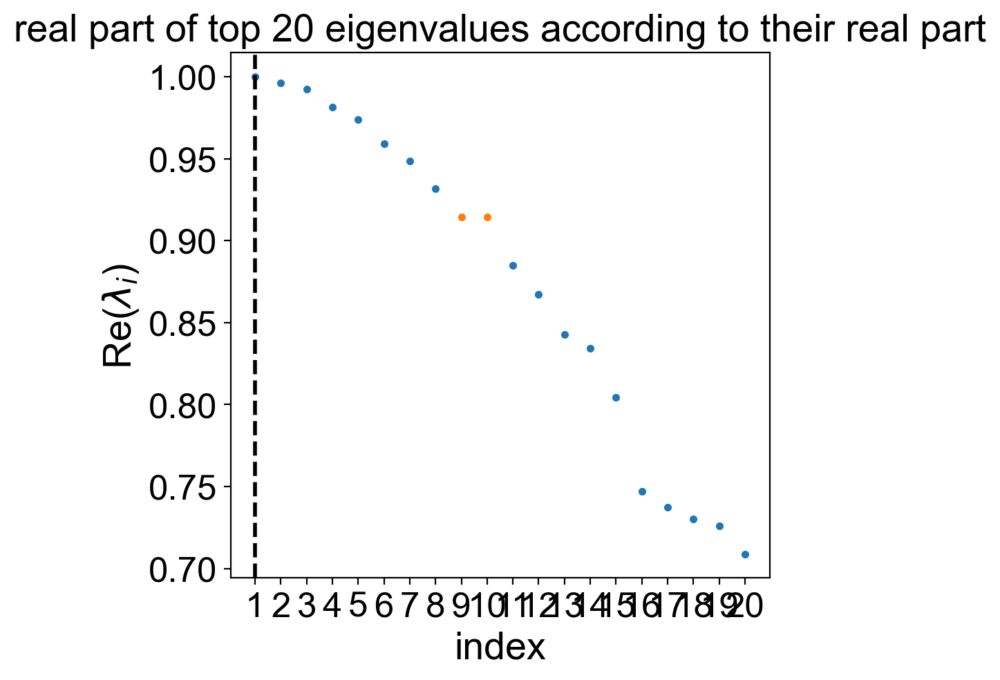

In [38]:
g.compute_schur()
g.plot_spectrum(real_only=True)

/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_macrostates.pdf


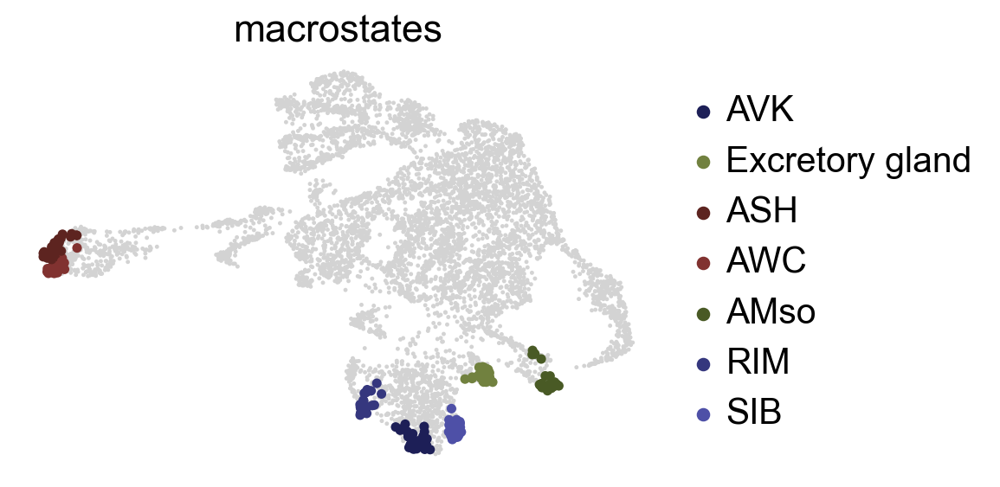

In [39]:
g.compute_macrostates(n_states=7, cluster_key="clusters")

fig_kwargs = {'legend_loc': 'right', 's': 100}
if save_figure: fig_kwargs['save'] =  "umap_macrostates.pdf"

g.plot_macrostates(**fig_kwargs)

Define the order of these macrostates

In [40]:
macrostates = ["ASH", "AWC", "AVK", "RIM", "SIB", "AMso", "Excretory_gland"]

g._macrostates_memberships = g.macrostates_memberships[macrostates]
g._macrostates = g.macrostates.cat.reorder_categories(macrostates)

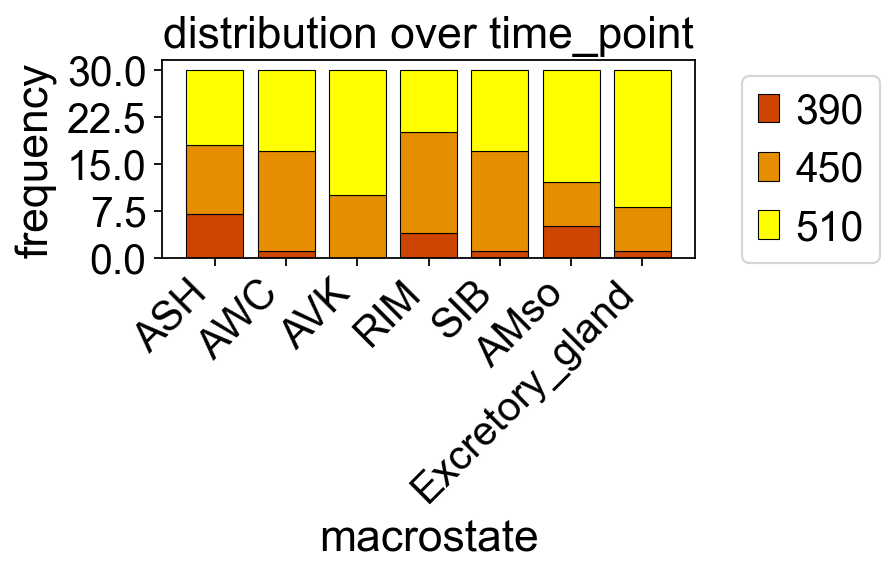

In [41]:
fig_kwargs = {'key': 'time_point', 'figsize': (6, 4)}
if save_figure: fig_kwargs['save'] =  "bar_time_point.pdf"

g.plot_macrostate_composition(**fig_kwargs, )

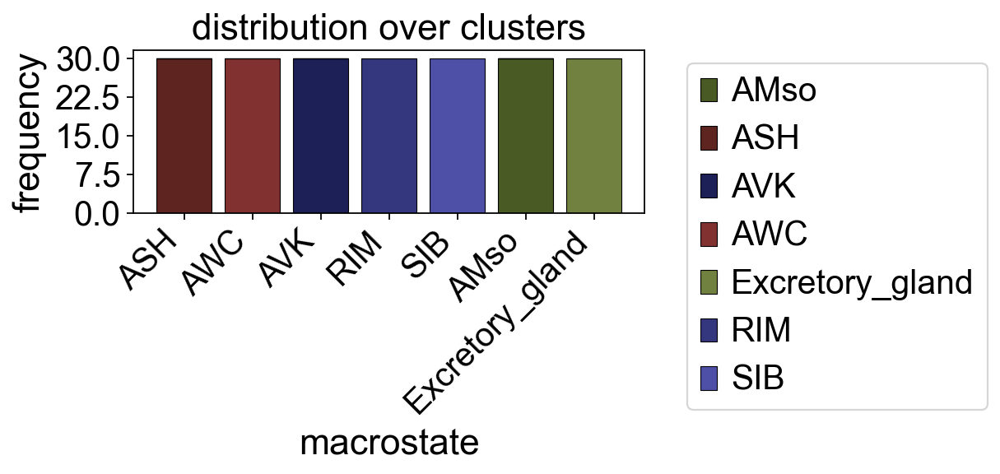

In [42]:
fig_kwargs = {'key': 'clusters', 'figsize': (8, 4)}
if save_figure: fig_kwargs['save'] =  "bar_clusters.pdf"

g.plot_macrostate_composition(**fig_kwargs)

## Compute fate probabilities towards all terminal states

In [43]:
g.set_terminal_states_from_macrostates(names=None)

GPCCA[kernel=(0.9 * CelegansKernel[n=6476] + 0.1 * ConnectivityKernel[n=6476]), terminal_states=['AMso', 'ASH', 'AVK', 'AWC', 'Excretory_gland', 'RIM', 'SIB'], macrostates=['AMso', 'ASH', 'AVK', 'AWC', 'Excretory_gland', 'RIM', 'SIB']]

/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


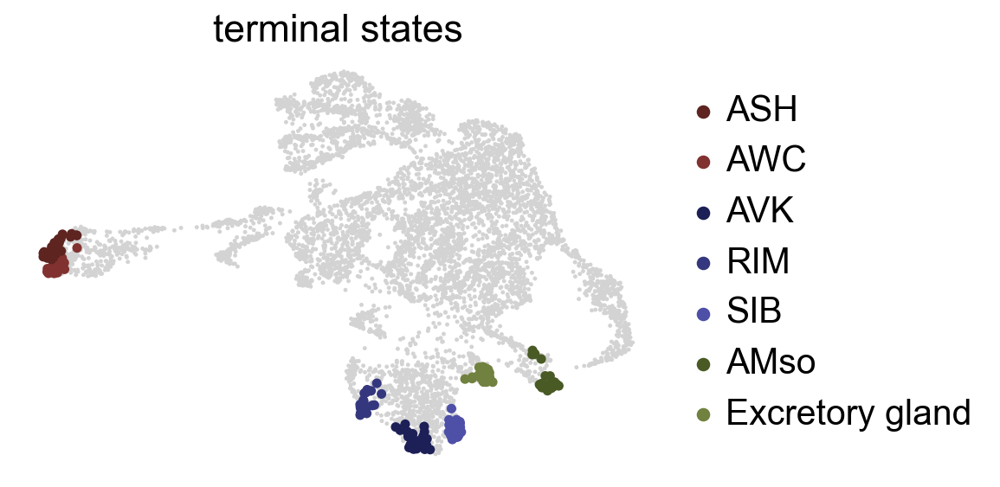

In [44]:
g.plot_terminal_states(legend_loc='right', s=100)

In [45]:
g.compute_absorption_probabilities()

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  "umap_all_fate_probs.pdf"

g.plot_absorption_probabilities(same_plot=False, s=50, dpi=DPI_SAVE, **fig_kwargs)

100%|██████████████████████████████████████████████████████████████████████████████████| 7/7 [00:01<00:00,  3.82/s]
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/User

saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_all_fate_probs.pdf


## Compute fate probabilities towards aggregated terminal states

This is a bit awkward in CellRank at the moment, but will be simplified in a future release. 

In [46]:
# Extract the cell indices for each group of cells
ciliated_ixs = list(g.macrostates[g.macrostates.isin(["ASH", "AWC"])].index)
non_ciliated_ixs = list(g.macrostates[g.macrostates.isin(["AVK", "RIM", "SIB"])].index)
glia_ixs = list(g.macrostates[g.macrostates.isin(["Excretory_gland", "AMso"])].index)

# Manually set these to be terminal
g.set_terminal_states(labels={"Ciliated_neuron": ciliated_ixs,
                             "Non_ciliated_neuron": non_ciliated_ixs,
                             "Glia_and_excretory": glia_ixs}, 
                      cluster_key="coarse_clusters")

GPCCA[kernel=(0.9 * CelegansKernel[n=6476] + 0.1 * ConnectivityKernel[n=6476]), terminal_states=['Ciliated neuron', 'Glia and excretory', 'Non-ciliated neuron'], macrostates=['AMso', 'ASH', 'AVK', 'AWC', 'Excretory_gland', 'RIM', 'SIB']]

In addition, assign nice colors to these aggregates states:

In [47]:
term_states_colors = {
    'Ciliated neuron': '#B3424C', 
    'Glia and excretory': '#95AD4D', 
    'Non-ciliated neuron': '#4C8EB4',
}

g._term_states_colors  = [term_states_colors[state] for state in g.terminal_states.cat.categories]
adata.uns["terminal_states_colors"] = [term_states_colors[state] for state in adata.obs["terminal_states"].cat.categories]

Plot the resulting aggregates terminal states

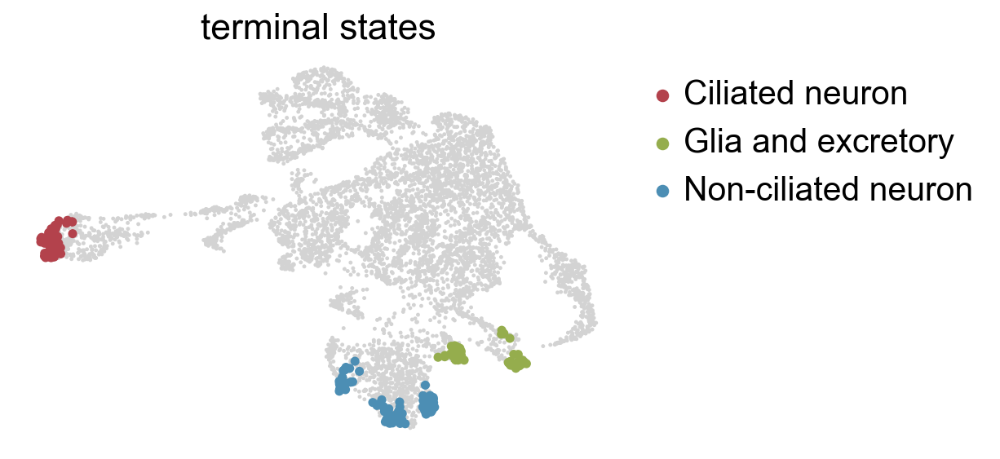

In [48]:
scv.pl.scatter(adata, c="terminal_states", s=100)

This combines the top 30 cells for each terminal state to represent the aggregated states. 

100%|██████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  2.40/s]
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_aggregated_fate_probabilities.pdf


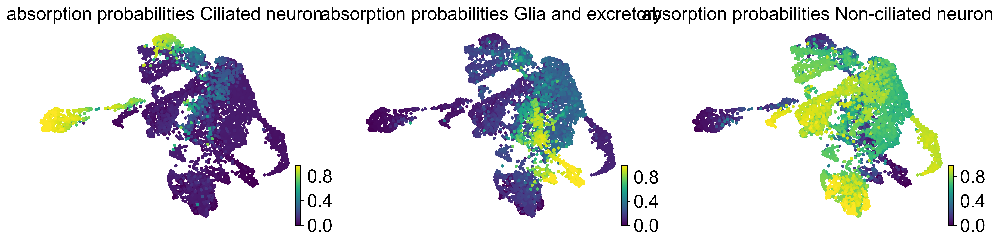

In [49]:
g.compute_absorption_probabilities()

fig_kwargs = {'same_plot': False, 'dpi': DPI_SAVE, 's': 50}
if save_figure: fig_kwargs['save'] =  "umap_aggregated_fate_probabilities.pdf"

g.plot_absorption_probabilities(**fig_kwargs)

## Visualize aggregated fate probabilities

Visualize the fate bias within progenitor cells

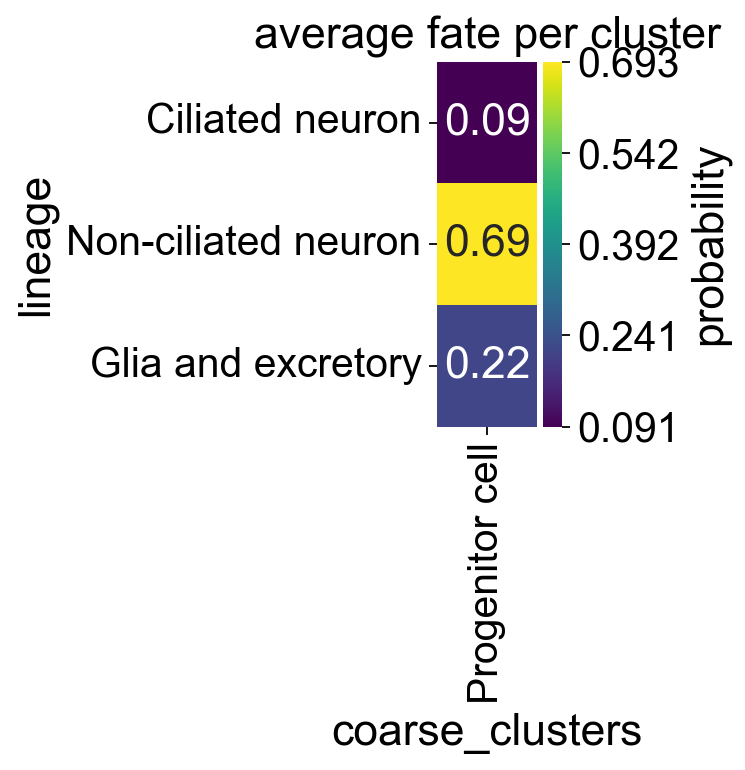

In [50]:
figure_kwargs = {'cluster_key': 'coarse_clusters', 
                 'mode': 'heatmap', 
                 'lineages': ['Ciliated neuron', 'Non-ciliated neuron', 'Glia and excretory'],
                 'clusters': ['Progenitor cell'], 'figsize': (1, 3)}
if save_figure: figure_kwargs['save'] = 'heatmap_progenitor_bias.pdf'
cr.pl.aggregate_absorption_probabilities(adata, **figure_kwargs)

Visualize fate probabilities as violin plots, grouped by preterminal state

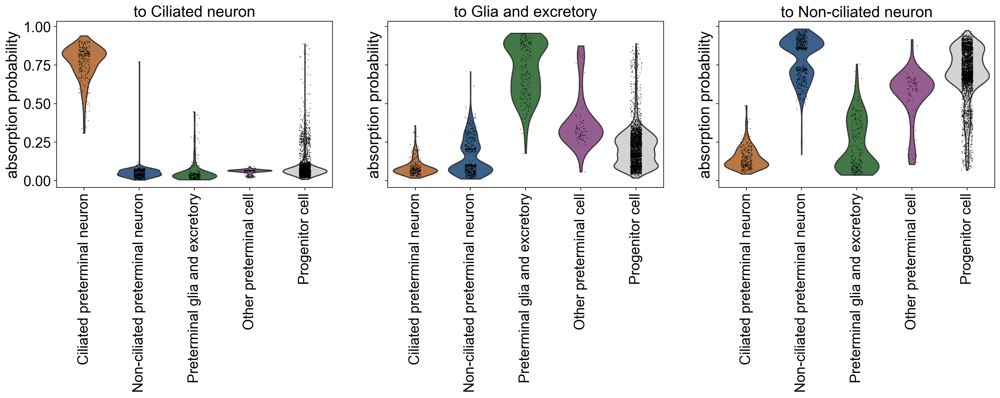

In [51]:
# subset to the interesting categories (i.e. not the final cell types)
clusters = ['Ciliated preterminal neuron',
       'Preterminal glia and excretory',
        'Non-ciliated preterminal neuron', 
            'Other preterminal cell', 
           'Progenitor cell']

mask = np.in1d(adata.obs["coarse_clusters"], clusters)

# and plot
fig_kwargs = {'mode': 'violin', 'cluster_key': 'coarse_clusters', 'clusters': clusters}
if save_figure: fig_kwargs['save'] =  "violin_aggregated_fate_probabilities.pdf"

cr.pl.aggregate_absorption_probabilities(adata[mask], sharey=True, **fig_kwargs)

Quantify this using t-tests. Define which states I would like to test, and what the background distribution is. 

In [52]:
states_to_test = ["Ciliated neuron", "Non-ciliated neuron", "Glia and excretory"]
background_all = ['Preterminal glia and excretory', 'Non-ciliated preterminal neuron', 
                  'Ciliated preterminal neuron', 'Progenitor cell']
obs_key = "coarse_clusters"

Iterate over these states, remove always one from the background, and do the t-test of target vs. background. 

In [53]:
for state in states_to_test:
    
    # get the fate probabilities towards this state
    fate_probs = g.absorption_probabilities[state]

    # determine the background cells
    background = background_all.copy()
    if state == "Ciliated neuron":
        background.remove("Ciliated preterminal neuron")
    elif state == "Non-ciliated neuron":
        background.remove("Non-ciliated preterminal neuron")
    elif state == "Glia and excretory":
        background.remove("Preterminal glia and excretory")
    else:
        raise ValueError(f"State {state} not found.")
    
    # set up mask for target and background cells
    mask_background = np.in1d(adata.obs[obs_key], background)
    mask_target = np.in1d(adata.obs[obs_key], [state])
    
    # retrieve fate probabilities for both, target and background cells
    background = fate_probs[mask_background]
    target = fate_probs[mask_target]

    print(f"For {state}, there are {np.sum(mask_background)} cell in the background and {np.sum(mask_target)} cell in the target.")
    print(f"The t-test result is: {ttest_ind(target, background, equal_var=False)}. \n")

For Ciliated neuron, there are 4179 cell in the background and 647 cell in the target.
The t-test result is: Ttest_indResult(statistic=array([40.69066552]), pvalue=array([6.39447164e-182])). 

For Non-ciliated neuron, there are 3882 cell in the background and 890 cell in the target.
The t-test result is: Ttest_indResult(statistic=array([29.31298738]), pvalue=array([2.96906624e-160])). 

For Glia and excretory, there are 4227 cell in the background and 361 cell in the target.
The t-test result is: Ttest_indResult(statistic=array([82.16951965]), pvalue=array([2.12919552e-255])). 



## Compute lineage drivers

In [54]:
corrs = g.compute_lineage_drivers()

# Merge this on the `.var` annotation to have information about which of these are also TFs!
new_var = adata.var.merge(right=corrs, how='left', left_index=True, right_index=True)

# make sure the index is exactly the same as in adata.var
assert((adata.var.index == new_var.index).all()), "Indices do not fully overlap"

# put the new var anntations in place
adata.var = new_var

Driver genes for Ciliated neurons: 

In [55]:
ciliated_df = return_drivers(adata, state="Ciliated neuron", n_genes = 20, only_tf = True)
ciliated_df

,Ensembl,highly_variable,Family,TF,Protein,Ciliated neuron_pval,Ciliated neuron_qval,Ciliated neuron_corr,means,dispersions
gene_short_name,,,,,,,,,,
daf-19,WBGene00000914,True,RFX,True,F33H1.1d.1;F33H1.1e.1;F33H1.1a.1;F33H1.1b.1;F3...,0.000000e+00,0.000000e+00,0.479336,0.148558,1.067321
ceh-57,WBGene00007416,True,Homeobox,True,C07E3.5.1;,1.930925e-224,3.472712e-222,0.377822,0.023640,0.675483
ceh-36,WBGene00000457,True,Homeobox,True,C37E2.4.1;,6.765902e-171,1.055412e-168,0.333147,0.353916,2.200174
T03G11.3,WBGene00020196,True,zf-C2H2,True,T03G11.3.1;,4.106060e-158,6.214786e-156,0.321209,0.060468,1.138707
sox-4,WBGene00015716,True,HMG,True,C12D12.5a.1;C12D12.5b.1;,3.965232e-157,5.885097e-155,0.320265,0.043131,1.701779
syd-9,WBGene00044068,True,zf-C2H2,True,ZK867.1d.1;ZK867.1c.1;,1.295149e-122,1.692217e-120,0.284612,0.726670,1.730344
sptf-1,WBGene00009743,True,zf-C2H2,True,F45H11.1b.1;F45H11.1a.1;,1.075167e-119,1.369673e-117,0.281335,0.680558,2.054025
fkh-2,WBGene00001434,True,Fork_head,True,T14G12.4a.1;T14G12.4b.2;T14G12.4b.1;,6.820308e-119,8.616699e-117,0.280426,0.196830,1.857609
cey-4,WBGene00000475,False,CSD,True,Y39A1C.3.1;Y39A1C.3.2;,8.827281e-107,1.054239e-104,0.266240,0.669581,0.485932


Driver genes for Non-ciliated neurons: 

In [56]:
non_ciliated_df = return_drivers(adata, state="Non-ciliated neuron", n_genes = 20, only_tf = True)
non_ciliated_df

,Ensembl,highly_variable,Family,TF,Protein,Non-ciliated neuron_pval,Non-ciliated neuron_qval,Non-ciliated neuron_corr,means,dispersions
gene_short_name,,,,,,,,,,
unc-62,WBGene00006796,True,Homeobox,True,T28F12.2h.1;T28F12.2e.1;T28F12.2b.2;T28F12.2f....,6.594565e-161,2.400265e-158,0.323868,0.686969,2.348703
fax-1,WBGene00001400,True,RXR-like,True,F56E3.4a.1;F56E3.4b.1;,3.412197e-109,6.065379e-107,0.269138,0.577109,2.776687
zag-1,WBGene00006970,False,zf-C2H2,True,F28F9.1.1;,1.235929e-103,2.031575e-101,0.262403,0.238246,0.799084
ceh-27,WBGene00000449,False,Homeobox,True,F46F3.1b.1;F46F3.1a.1;,1.174059e-81,1.495653e-79,0.233508,0.934959,1.840021
cnd-1,WBGene00000561,True,bHLH,True,C34E10.7.1;,5.990780e-74,7.044696e-72,0.222336,1.021370,3.019688
hmg-1.1,WBGene00001971,False,HMG,True,Y48B6A.14.1;Y48B6A.14.2;,1.235680e-67,1.250983e-65,0.212685,2.202403,1.067535
hlh-13,WBGene00001957,True,bHLH,True,F48D6.3.1;,1.548162e-66,1.517100e-64,0.210957,0.910839,3.940609
unc-3,WBGene00006743,True,COE,True,Y16B4A.1.1;,2.185977e-51,1.646159e-49,0.185272,0.601572,2.650901
ceh-13,WBGene00000437,True,Homeobox,True,R13A5.5.1;R13A5.5.2;,8.693476e-48,6.068364e-46,0.178573,0.140581,0.996781


Driver genes for Glia and excretory cells:

In [57]:
glia_df = return_drivers(adata, state="Glia and excretory", n_genes = 20, only_tf = True)
glia_df

,Ensembl,highly_variable,Family,TF,Protein,Glia and excretory_pval,Glia and excretory_qval,Glia and excretory_corr,means,dispersions
gene_short_name,,,,,,,,,,
ceh-37,WBGene00000458,True,Homeobox,True,C37E2.5a.1;C37E2.5b.1;C37E2.5a.2;C37E2.5c.1;C3...,9.064987e-218,7.293497e-215,0.372658,0.330520,2.251799
nhr-23,WBGene00003622,True,THR-like,True,C01H6.5b.1;C01H6.5c.1;C01H6.5d.1;C01H6.5e.1;C0...,3.342036e-164,1.344466e-161,0.326967,0.044760,1.231052
pros-1,WBGene00000448,True,HPD,True,K12H4.1.1;,1.322538e-162,5.184008e-160,0.325470,0.107671,1.705514
atf-8,WBGene00017535,True,TF_bZIP,True,F17A9.3.1;,4.755539e-155,1.773120e-152,0.318260,0.223548,3.021758
alr-1,WBGene00044330,True,Homeobox,True,R08B4.2.1;,1.489238e-141,4.843826e-139,0.304830,0.059831,1.052620
lim-6,WBGene00002988,True,Homeobox,True,K03E6.1b.1;K03E6.1a.1;,2.659513e-125,7.009650e-123,0.287589,0.247609,2.543061
ttx-1,WBGene00006652,True,Homeobox,True,Y113G7A.6a.1;Y113G7A.6b.1;Y113G7A.6d.1;Y113G7A...,1.030316e-91,1.750049e-89,0.247221,0.131875,1.100395
ref-2,WBGene00004335,True,zf-C2H2,True,C47C12.3a.1;C47C12.3b.1;C47C12.3a.2;,6.448022e-77,8.646571e-75,0.226712,0.157262,0.989847
unc-130,WBGene00006853,True,Fork_head,True,C47G2.2.1;,4.928425e-72,6.125271e-70,0.219459,0.036579,0.841971


## Driver gene visualization

Start by defining a custom colormap, containing just two colors, one for TFs, one for all other genes. 

In [58]:
# Define a list of colors
colors = ["#C0C0C0", "#000000"]

# Normalize the colormap range
cmap_range = mcolors.Normalize(vmin=0, vmax=len(colors))

# Create the colormap object
cmap = mcolors.ListedColormap(colors)

Define gene sets which should be annotated in the scatter plot. 

In [59]:
# define some gene sets
ciliated_genes = ["daf-19", "fkh-2", "sptf-1"]
non_ciliated_genes = ["cnd-1", "fax-1", "zag-1"]
glia_excretory_genes = ["alr-1", "pros-1", "unc-130"]  

genes_oi = {
    "Ciliated neuron": ciliated_genes,
    "Non-ciliated neuron": non_ciliated_genes,
    "Glia and excretory": glia_excretory_genes,
}

Plot the actual scatter plot. 

In [60]:
fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  "scatter_gene_correlations_annotations.pdf"

# call the actual plotting method via the estimator object
g.plot_lineage_drivers_correlation(
    lineage_x="Non-ciliated neuron", 
    adjust_text=True, 
    lineage_y="Ciliated neuron",
    gene_sets=genes_oi,
    color="TF", 
    cmap=cmap,
    legend_loc="none",
    figsize=(25, 25),
    dpi=150,
    fontsize=20,
    title="driver genes",
    size=50,
    **fig_kwargs
)

ERROR: Please install `adjustText` first as `pip install adjustText`


Show without gene annotations

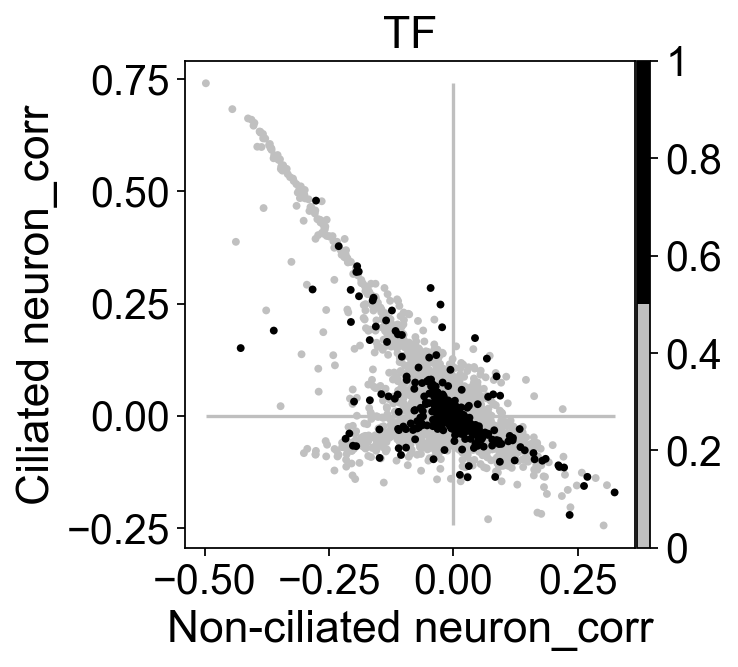

In [61]:
# call the actual plotting method via the estimator object
ax = g.plot_lineage_drivers_correlation(
    lineage_x="Non-ciliated neuron", 
    adjust_text=True, 
    lineage_y="Ciliated neuron",
    color="TF", 
    cmap=cmap,
    legend_loc="none",
    title="driver genes",
    size=50,
    show=False, 
)

# adjust and save
ax.set_xticks([-0.5, -0.25, 0.0, 0.25])
if save_figure:
    plt.savefig(FIG_DIR / "scatter_gene_correlations.pdf")
    
plt.show()

Highlight expression values, for Ciliated Neuron drivers: 

/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDepreca

saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_ciliated_genes.pdf


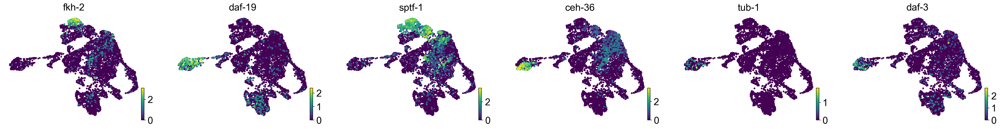

In [62]:
# define the gene set
cil_genes = [ "fkh-2",  "daf-19", "sptf-1", "ceh-36", "tub-1", "daf-3"]

# make sure they are all in the top-20 best correlating TFs for this trajectory
assert([gene in ciliated_df.index for gene in cil_genes]), "Missing some ciliated genes"

# show their UMAP-epxression
fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  "umap_ciliated_genes.pdf"

scv.pl.scatter(adata, c=cil_genes, s=50, **fig_kwargs)

Next, for non-ciliated neurons: 

/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDepreca

saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_non_ciliated_genes.pdf


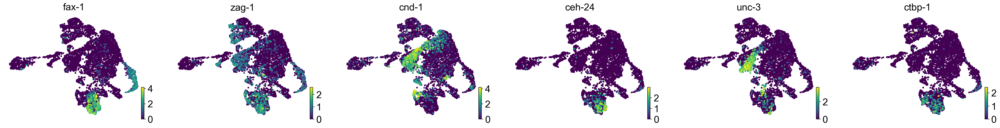

In [63]:
# define the gene set
non_cil_genes = [ "fax-1", "zag-1", "cnd-1", "ceh-24", "unc-3", "ctbp-1"]

# make sure they are all in the top-20 best correlating TFs for this trajectory
assert([gene in non_ciliated_df.index for gene in non_cil_genes]), "Missing some non-ciliated genes"

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  "umap_non_ciliated_genes.pdf"

scv.pl.scatter(adata, c=non_cil_genes, s=50, **fig_kwargs)

Lastly, for glia and excretory cells: 

/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDepreca

saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_glia_excretory_genes.pdf


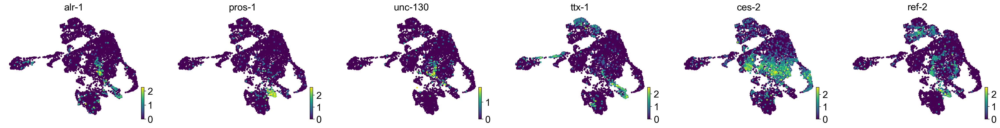

In [64]:
# define the gene set
glia_genes = ["alr-1", "pros-1", "unc-130", "ttx-1", "ces-2", "ref-2"]

# make sure they are all in the top-20 best correlating TFs for this trajectory
assert([gene in glia_df.index for gene in glia_genes]), "Missing some Glia and excretory genes"

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  "umap_glia_excretory_genes.pdf"

scv.pl.scatter(adata, c=glia_genes, s=50, **fig_kwargs)

## Show smoothed expression in time

Set global gene-trend fitting parameters:

In [65]:
pseudotime = 'palantir_pseudotime'
data_key = 'magic_imputed_data'
state = "Non-ciliated neuron"

# mgcv settings
n_knots_mgcv = 6

weight_threshold_mgcv = (1e-3, 1e-3)
smoothing_penalty_mgcv = 10.0

Select putative driver genes, including genes that are not TFs. 

In [66]:
driver_corr = return_drivers(adata, state=state, n_genes=50, only_tf=False)

How many of these are TFs?

In [67]:
np.sum(driver_corr["TF"])

11

Plot their smoothed expression along pseudotime in a heatmap. 

100%|████████████████████████████████████████████████████████████████████████████| 50/50 [00:02<00:00, 24.36gene/s]


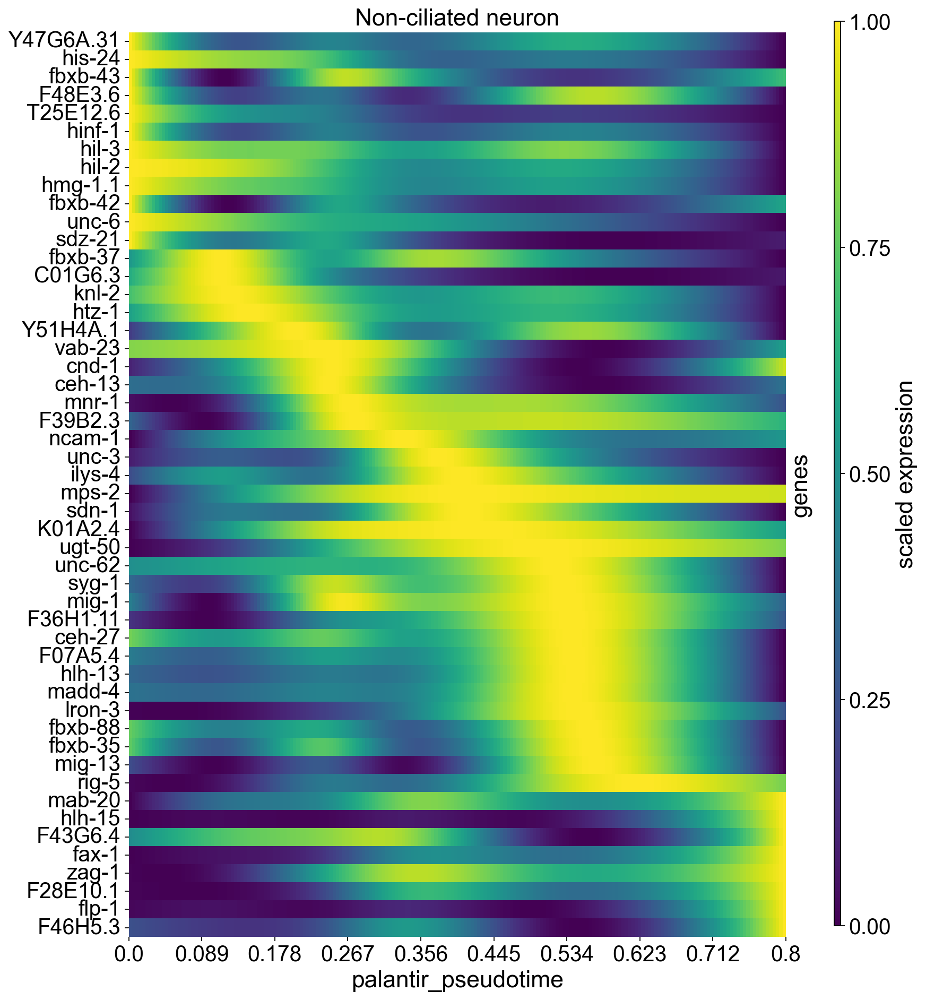

In [68]:
with warnings.catch_warnings():
    warnings.filterwarnings("ignore", category=DeprecationWarning)
    
    model = cr.models.GAMR(adata, n_knots=n_knots_mgcv, smoothing_penalty=smoothing_penalty_mgcv)
    fig_kwargs = {'model': model, 
                  'genes': driver_corr.index, 
                  'lineages': state, 
                  'data_key': data_key, 
                  'time_key': pseudotime, 
                  'show_absorption_probabilities': False, 
                  'figsize': (12, 14), 
                  'show_all_genes': True, 
                  'weight_threshold': weight_threshold_mgcv}
    
    if save_figure: fig_kwargs['save'] =  "heatmap_drivers.pdf"

    cr.pl.heatmap(adata, **fig_kwargs)  

## Predict new TFs 

Visualize some new, predicted TFs. 

/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/Users/marius/miniforge3/envs/py39_arm_moslin/lib/python3.9/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


saving figure to file /Users/marius/Projects/moslin_reproducibility/figures/packer_c_elegans/umap_non_ciliated_new_candidates.pdf


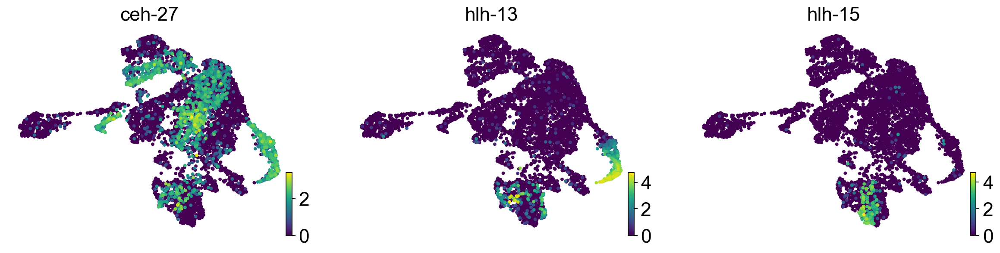

In [69]:
new_candidates = ["ceh-27", "hlh-13", "hlh-15"]

fig_kwargs = {}
if save_figure: fig_kwargs['save'] =  "umap_non_ciliated_new_candidates.pdf"

scv.pl.scatter(adata, c=new_candidates, s=50, **fig_kwargs)